In [1]:
import os
os.chdir("") # put working dir here

In [91]:
"""Define a custom wrapper to incorporate changes when loading from dict"""
from src.models.VQ_PAE import VQ_AE
from src.utils.helpers import DotDict

import torch

class ModelWrapper(VQ_AE):  # Inherit from the original model
    def __init__(self, cfg: DotDict, ctrl_idx: list[int] = None, vq_mask: bool = False, latent_mask: bool = False):
        super(ModelWrapper, self).__init__(cfg)
        self.vq_mask = vq_mask # if true the vq part will not be used by the latent combiner
        self.latent_mask = latent_mask
        
        if ctrl_idx is not None:
            for idx in ctrl_idx:
                assert self.embedding_channels > idx >= 0 
            self._ctrl_idx = ctrl_idx # the latent signals with these indices will be set to 0
        else:
            self._ctrl_idx = None
                    

    @property
    def ctrl_idx(self):
        return self._ctrl_idx

    @ctrl_idx.setter
    def ctrl_idx(self, val):
        # Set the private attribute in the setter
        for idx in val:
            assert self.embedding_channels > idx >= 0 
        self._ctrl_idx = val # the latent signals with these indices will be set to 0

    def forward(self, x, n_quantizers: int = None):
        z = self.encode(x)
        z_pae = z

        # RVQ
        z_vq = z
        z_vq, codes, latents, commitment_loss, codebook_loss = self.quantizer(z_vq, n_quantizers)
        z_comb = z_vq

        # Disentangle phase
        z_recon, phase_params = None, None
        if not self.vq_only:
            z_phase = z
            f, a, b = self.FFT(z_phase, dim=2)

            p = torch.empty((z_phase.shape[0], self.embedding_channels), dtype=torch.float32, device=z_phase.device)
            for i in range(self.embedding_channels):
                v = self.fc[i](z_phase[:, i, :])
                p[:, i] = torch.atan2(v[:, 1], v[:, 0]) / self.tpi

            p = p.unsqueeze(2)
            f = f.unsqueeze(2)
            a = a.unsqueeze(2)
            b = b.unsqueeze(2)

            phase_params = [p, f, a, b]
            z_recon = a * torch.sin(self.tpi * (f * self.args + p)) + b

            # Apply ctrl logic
            if self.vq_mask:
                z_vq = torch.zeros_like(z_vq)
                
            if self.ctrl_idx is not None:
                z_recon[:, self.ctrl_idx, :] = 0
                
            if self.latent_mask:
                z_recon = torch.zeros_like(z_recon)

            # Combine latent features
            z_comb = self.latent_combinator(z_recon, z_vq)

        # Signal reconstruction
        x = self.decode(z_comb)
        return {
            "audio": x[..., :self.time_range],
            "z_pae": z_pae, 
            "z_vq": z_vq,
            "z_recon": z_recon,
            "phase_params": phase_params,
            "codes": codes,
            "latents": latents,
            "vq/commitment_loss": commitment_loss,
            "vq/codebook_loss": codebook_loss,
        }

In [92]:
from src.experiments.vq_pae import VQ_PAEModel
from src.utils.config import load_config

cfg_path = "configs/vq_pae/vq_pae_tiny.yaml"
model_ckpt_path = "logs/checkpoints_cluster/pae_tiny_twinkle_100eps.ckpt"
device = "cuda" if torch.cuda.is_available() else "cpu"

# load model wrapper
cfg = load_config(cfg_path, flatten=False)
print(cfg)
lightning_model = VQ_PAEModel.load_from_checkpoint(model_ckpt_path, cfg=cfg, strict=False)
orig_model = lightning_model.model

# Initialize the new model wrapper
model = ModelWrapper(cfg.model_config)
model.load_state_dict(orig_model.state_dict(), strict=False)
model.to(device)
print(model)


{'metadata': {'run_name': 'VQ_PAE_tiny', 'log_dir': 'logs', 'logging': True}, 'dataset_config': {'dataset': 'audio_dataset', 'dataset_root': 'data', 'resume': None}, 'training_config': {'grid_search': False, 'num_epochs': 1000, 'batch_size': 16, 'batch_size_validation': 16, 'optimizer': 'adam', 'optimizer_lr': 0.001, 'optimizer_momentum': 0.9, 'optimizer_weight_decay': 0.001, 'optimizer_float_16': False, 'lr_scheduler': 'poly', 'lr_scheduler_power': 0.9, 'ckpt_save_dir': 'logs/checkpoints', 'resume': None}, 'loss_config': {'loss_weights': {'mse_loss': 1.0, 'l1_loss': 2.0, 'sisdr_loss': 0.0, 'stft_loss_spectral_convergence': 20.0, 'stft_loss_magnitude': 1.0, 'mel_spectrogramm_loss': 15.0, 'vq/commitment_loss': 1.0, 'vq/codebook_loss': 0.25}}, 'model_config': {'experiment_name': 'VQ_PAEModel', 'model_name': 'vq_pae', 'vq_only': False, 'input_channels': 1, 'intermediate_channels': 64, 'embedding_channels': 64, 'time_range': 32000, 'window': 2.0, 'use_fft_mlp': False, 'enc_dilation_rates':

/Users/hxi/.pyenv/versions/3.10.4/lib/python3.10/site-packages/torch/nn/init.py:511: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")
/Users/hxi/.pyenv/versions/3.10.4/lib/python3.10/site-packages/torch/nn/utils/weight_norm.py:143: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


In [93]:
from src.datasets.data_processing import AudioDataset

model.eval()

# load dataset
D_test = AudioDataset(dataset_root='data', split='test')
D_train = AudioDataset(dataset_root='data', split='train')
x_train_sample = D_train[0]
x_test_sample = D_test[0]
print("test sample: ", x_test_sample)

# get model outputs
pred = model(x_test_sample.unsqueeze(0)) 
x_recon = pred["audio"] # x_recon
z_pae = pred["z_pae"]   # B, emb_ch, L
z_vq = pred["z_vq"]     # B, emb_ch, L
z_recon = pred["z_recon"] # B, L
phase_params = pred["phase_params"] # p, f, a, b
codes = pred["codes"]                  # B, n_codebooks, L
latents = pred["latents"]               # B, n_codebooks x codebook_dim, L
vq_comm_loss = pred["vq/commitment_loss"]
vq_cb_loss = pred["vq/codebook_loss"]

print("latent signal params (p, f, a, b): ", phase_params)
print(f"orig signal shape: {x_test_sample.shape}, latent signal shape: {z_recon.shape}")

test sample:  tensor([-4.3570e-05,  1.0285e-06,  1.5197e-05,  ...,  7.3522e-02,
         8.8069e-02,  9.9308e-02])
latent signal params (p, f, a, b):  [tensor([[[-0.4531],
         [-0.4916],
         [-0.3924],
         [ 0.0292],
         [ 0.0522],
         [-0.3271],
         [-0.3363],
         [-0.3576],
         [ 0.4932],
         [ 0.4991],
         [ 0.0590],
         [-0.3878],
         [ 0.4564],
         [-0.2205],
         [-0.1333],
         [-0.0277],
         [ 0.4163],
         [-0.3894],
         [ 0.3126],
         [ 0.4776],
         [ 0.0969],
         [-0.4359],
         [-0.2430],
         [ 0.2168],
         [-0.0666],
         [ 0.3783],
         [ 0.4763],
         [-0.2945],
         [-0.4614],
         [-0.4414],
         [-0.2660],
         [-0.3851],
         [ 0.2387],
         [-0.2392],
         [ 0.4458],
         [ 0.0381],
         [ 0.1923],
         [ 0.0940],
         [ 0.2883],
         [ 0.4885],
         [ 0.0990],
         [-0.3447],
        

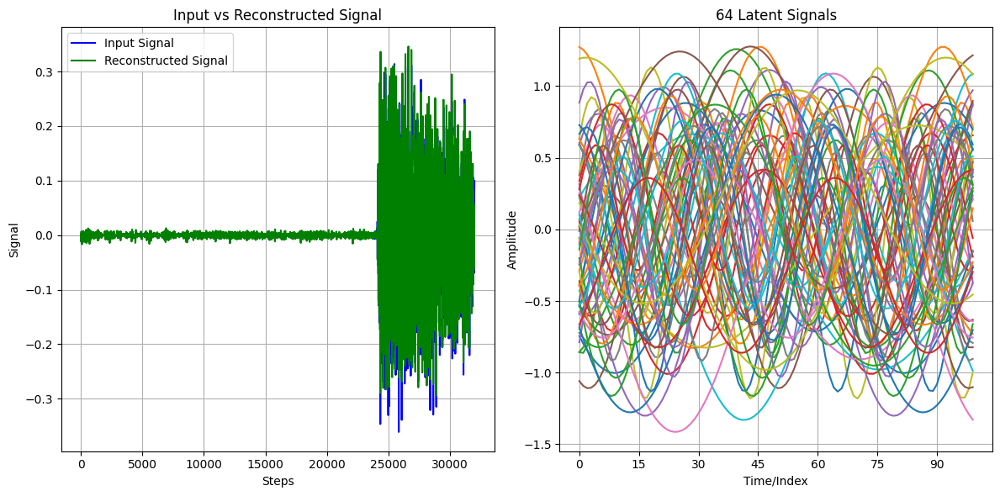

In [94]:
%matplotlib inline
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

# plot the output against the input signal, and the latent signals
# Plot input signal x against output signal y
def plot_reconstruction(x, x_pred, z_recon, *, length: int = 32000):
    N = cfg.model_config.time_range
    K = cfg.model_config.embedding_channels
    T = length

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(np.arange(1, T+1), x.flatten()[:T], label="Input Signal", color="blue")
    plt.plot(np.arange(1, T+1), x_pred.detach().flatten()[:T], label="Reconstructed Signal", color="green")
    plt.xlabel("Steps")
    plt.ylabel("Signal")
    plt.title("Input vs Reconstructed Signal")
    plt.legend()
    plt.grid()

    # Plot each of the k signals in a different color
    plt.subplot(1, 2, 2)
    for i in range(K):
        plt.plot(range(100), z_recon[0, i, :100].detach(), label=f"Signal {i+1}")
    plt.xlabel("Time/Index")
    plt.ylabel("Amplitude")
    plt.title(f"{K} Latent Signals")
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
    # plt.legend()
    plt.grid()

    # Show the plots
    plt.tight_layout()
    plt.show()
    
plot_reconstruction(x_test_sample, x_recon, z_recon, length=32000)

In [95]:
"""Convert the audio to Wave and play it in Jupyter"""

from scipy.io.wavfile import write
from IPython.display import Audio, display

def to_audio(x, sample_rate=16000, file_name="audio.wav"):
    """
    Convert a 1D PyTorch tensor or numpy ndarray to audio and return a playback widget.
    
    Parameters:
        tensor (torch.Tensor): 1D tensor containing audio data.
        sample_rate (int): Sample rate of the audio.
        file_name (str): Temporary file name to save the audio.
    
    Returns:
        Audio: Jupyter widget to play the audio.
    """
    # Ensure the tensor is 1D and convert to numpy
    if isinstance(x, torch.Tensor):
        if len(x.shape) != 1:
            raise ValueError("Input tensor must be 1D.")
        audio_data = x.cpu().numpy()
    else:
        audio_data = x

    # Normalize audio to -1 to 1 range if necessary
    if np.max(np.abs(audio_data)) > 1.0:
        audio_data = audio_data / np.max(np.abs(audio_data))
    
    # Convert to 16-bit PCM format
    audio_data = (audio_data * 32767).astype(np.int16)
    
    # Save as a WAV file
    write(file_name, sample_rate, audio_data)
    
    # Create and return an audio playback widget
    return Audio(file_name, rate=sample_rate)

# Example usage
# Generate a test sine wave
sample_rate = 16000
duration = 2  # seconds

# Convert the tensor to audio and play it
audio_widget = to_audio(x_recon.squeeze().detach(), sample_rate=sample_rate)
display(audio_widget)

In [97]:
from tqdm import tqdm
import soundfile as sf
import scipy.signal as signal

def process_audio(file_path, steps: int = None, lowpass_cutoff=8000, original_rate=44100, target_rate=16000, window_length=2):

    audio, sr = sf.read(file_path)
    audio = np.mean(audio, axis=1) #Convert audio to mono
    assert sr == original_rate, f"Expected {original_rate} Hz, but got {sr} Hz"
    
    # low-pass filter
    nyquist = sr / 2
    norm_cutoff = lowpass_cutoff / nyquist
    b, a = signal.butter(5, norm_cutoff, btype='low')
    filtered_audio = signal.filtfilt(b, a, audio)
    
    # Downsample the audio to 16 KHz
    downsampled_audio = signal.resample_poly(filtered_audio, target_rate, sr)
    
    # normalize to -1 to 1
    downsampled_audio = downsampled_audio / np.max(np.abs(downsampled_audio))
    
    # make 2-second windows
    window_size = target_rate * window_length

    out_samples = []
    if steps is not None:
        assert steps < len(downsampled_audio) // window_size
    else:
        steps = len(downsampled_audio) // window_size
        
    with torch.set_grad_enabled(True):
        for i in tqdm(range(steps)):
            s = torch.tensor(downsampled_audio[i * window_size: (i+1) * window_size], device=device, requires_grad=True).float()
            pred = model(s.unsqueeze(0))
            x_recon = pred["audio"].squeeze(0)
            out_samples.append(x_recon)
    
    return downsampled_audio, torch.cat(out_samples, dim=0)

In [98]:
# Plot fully reconstructed song against ground truth
def plot_full_song(steps=20):
    x, x_pred = process_audio("data/twinkletwinkle-44100khz.wav", steps=steps)
    print(x_pred.shape)  
    audio_widget = to_audio(x.squeeze(), sample_rate=16000)
    display(audio_widget)
    audio_widget_pred = to_audio(x_pred.squeeze().detach(), sample_rate=16000)
    display(audio_widget_pred)
    length = 16000 * steps # secs
    plot_reconstruction(x, x_pred, z_recon, length=length)

100%|██████████| 10/10 [00:06<00:00,  1.58it/s]

torch.Size([320000])


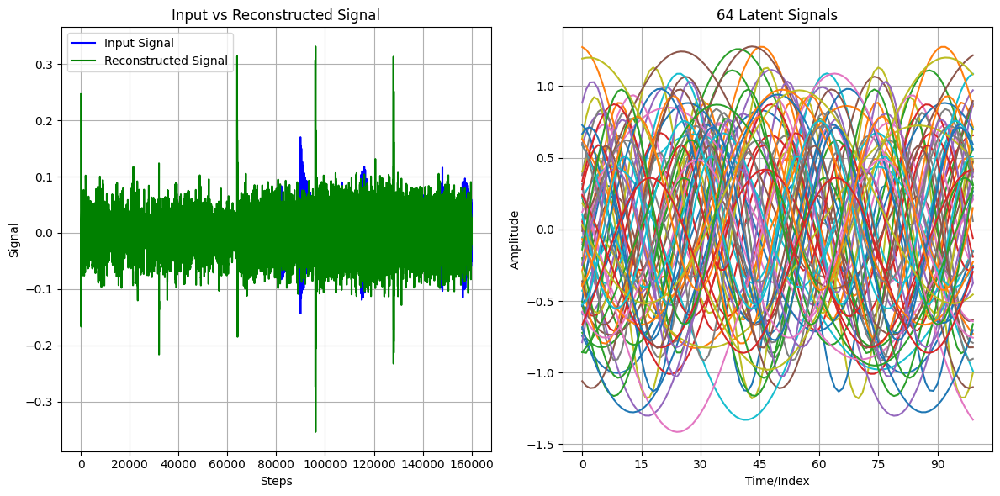

In [103]:
model.vq_mask = True
model.latent_mask = False
# model.ctrl_idx = torch.arange(1, 32, 1)
plot_full_song(steps=10)

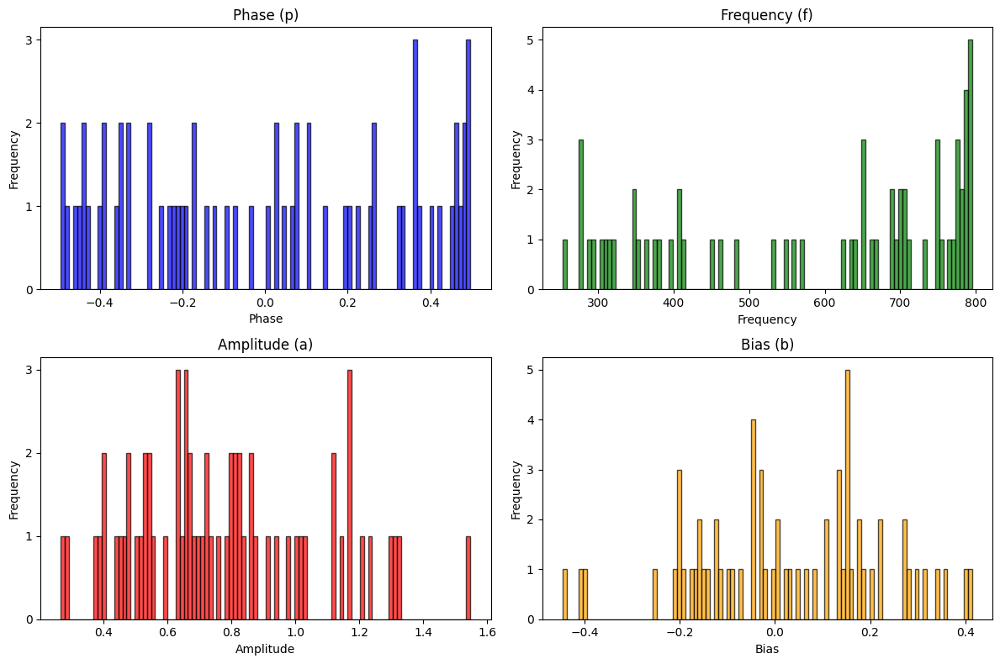

In [16]:
p, f, a, b = phase_params
n_bins = 100

# Create subplots for histograms
plt.figure(figsize=(12, 8))

# Phase (p)
plt.subplot(2, 2, 1)
plt.hist(p.detach().numpy().flatten(), bins=n_bins, color="blue", alpha=0.7, edgecolor="black")
plt.title("Phase (p)")
plt.xlabel("Phase")
plt.ylabel("Frequency")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))  # Ensure integer y-axis ticks


# Frequency (f)
plt.subplot(2, 2, 2)
plt.hist(f.detach().numpy().flatten(), bins=n_bins, color="green", alpha=0.7, edgecolor="black")
plt.title("Frequency (f)")
plt.xlabel("Frequency")
plt.ylabel("Frequency")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))  # Ensure integer y-axis ticks


# Amplitude (a)
plt.subplot(2, 2, 3)
plt.hist(a.detach().numpy().flatten(), bins=n_bins, color="red", alpha=0.7, edgecolor="black")
plt.title("Amplitude (a)")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))  # Ensure integer y-axis ticks


# Bias (b)
plt.subplot(2, 2, 4)
plt.hist(b.detach().numpy().flatten(), bins=n_bins, color="orange", alpha=0.7, edgecolor="black")
plt.title("Bias (b)")
plt.xlabel("Bias")
plt.ylabel("Frequency")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))  # Ensure integer y-axis ticks


plt.tight_layout()
plt.show()